In [2]:
import numpy as np 
import pandas as pd 
import matplotlib.pyplot as plt
import plotly.graph_objects as go
import plotly.express as px
from plotly.offline import init_notebook_mode
init_notebook_mode(connected=True)

pd.set_option('display.max_rows', None)
from plotly.subplots import make_subplots
import seaborn as sns
import datetime

In [3]:
data = pd.read_csv('C:/Users/walid/Desktop/novel-corona-virus-2019-dataset/covid_19_data.csv')


In [4]:
#Percentage of NAN Values 
NAN = [(c, data[c].isna().mean()*100) for c in data]
NAN = pd.DataFrame(NAN, columns=["column_name", "percentage"])
NAN

,column_name,percentage
0,SNo,0.000000
1,ObservationDate,0.000000
2,Province/State,25.487144
3,Country/Region,0.000000
4,Last Update,0.000000
5,Confirmed,0.000000
6,Deaths,0.000000
7,Recovered,0.000000


In [5]:
data["Province/State"]= data["Province/State"].fillna('Unknown')

In [6]:
data.head()

,SNo,ObservationDate,Province/State,Country/Region,Last Update,Confirmed,Deaths,Recovered
0,1,01/22/2020,Anhui,Mainland China,1/22/2020 17:00,1.0,0.0,0.0
1,2,01/22/2020,Beijing,Mainland China,1/22/2020 17:00,14.0,0.0,0.0
2,3,01/22/2020,Chongqing,Mainland China,1/22/2020 17:00,6.0,0.0,0.0
3,4,01/22/2020,Fujian,Mainland China,1/22/2020 17:00,1.0,0.0,0.0
4,5,01/22/2020,Gansu,Mainland China,1/22/2020 17:00,0.0,0.0,0.0


In [7]:
data[["Confirmed","Deaths","Recovered"]] =data[["Confirmed","Deaths","Recovered"]].astype(int)

In [8]:
data['Country/Region'] = data['Country/Region'].replace('Mainland China', 'China')

In [9]:
data['Active_case'] = data['Confirmed'] - data['Deaths'] - data['Recovered']
data.head()

,SNo,ObservationDate,Province/State,Country/Region,Last Update,Confirmed,Deaths,Recovered,Active_case
0,1,01/22/2020,Anhui,China,1/22/2020 17:00,1,0,0,1
1,2,01/22/2020,Beijing,China,1/22/2020 17:00,14,0,0,14
2,3,01/22/2020,Chongqing,China,1/22/2020 17:00,6,0,0,6
3,4,01/22/2020,Fujian,China,1/22/2020 17:00,1,0,0,1
4,5,01/22/2020,Gansu,China,1/22/2020 17:00,0,0,0,0


In [10]:
Data = data[data['ObservationDate'] == max(data['ObservationDate'])].reset_index()

In [11]:
data.head()

,SNo,ObservationDate,Province/State,Country/Region,Last Update,Confirmed,Deaths,Recovered,Active_case
0,1,01/22/2020,Anhui,China,1/22/2020 17:00,1,0,0,1
1,2,01/22/2020,Beijing,China,1/22/2020 17:00,14,0,0,14
2,3,01/22/2020,Chongqing,China,1/22/2020 17:00,6,0,0,6
3,4,01/22/2020,Fujian,China,1/22/2020 17:00,1,0,0,1
4,5,01/22/2020,Gansu,China,1/22/2020 17:00,0,0,0,0


In [12]:
Data_world = Data.groupby(["ObservationDate"])[["Confirmed","Active_case","Recovered","Deaths"]].sum().reset_index()

In [13]:
labels = ["Last Update","Confirmed","Active cases","Recovered","Deaths"]
fig = go.Figure(data=[go.Table(header=dict(values=labels),
                 cells=dict(values=Data_world.loc[0,["ObservationDate","Confirmed","Active_case","Recovered","Deaths"]]))
                     ])
fig.update_layout(
    title='Coronavirus dans le monde: ',
)
fig.show()


In [14]:
labels = ["Cas positifs","Soignes","Morts"]
values = Data_world.loc[0, ["Active_case","Recovered","Deaths"]]
fig = px.pie(Data_world, values=values, names=labels,color_discrete_sequence=['rgb(77,146,33)','rgb(69,144,185)','rgb(77,77,77)'],hole=0.7)
fig.update_layout(
    title='Cas totals : '+str(Data_world["Confirmed"][0]),
)
fig.show()

In [15]:
data_over_time= data.groupby(["ObservationDate"])[["Confirmed","Active_case","Recovered","Deaths"]].sum().reset_index().sort_values("ObservationDate",ascending=True).reset_index(drop=True)



In [16]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=data_over_time.index, y=data_over_time['Confirmed'],
                    mode='lines',
                    name='Confirmed cases'))


fig.update_layout(
    title='Evolution des cas confirmes dans le monde',
        template='plotly_white',
      yaxis_title="Cas confirmes",
    xaxis_title="Jours",

)

fig.show()

In [17]:
fig = go.Figure()


fig.add_trace(go.Scatter(x=data_over_time.index, y=data_over_time['Active_case'],
                    mode='lines',marker_color='yellow',
                    name='Active cases',line=dict( dash='dot')))

fig.update_layout(
    title='Evolution des cas actifs dans le monde',
        template='plotly_dark',
      yaxis_title="Cas actifs",
    xaxis_title="Jours",

)

fig.show()

In [18]:
fig = go.Figure()

fig.add_trace(go.Scatter(x=data_over_time.index, y=data_over_time['Recovered'],
                    mode='lines',
                    name='Recovered cases',marker_color='green'))

fig.update_layout(
    title='Evolution des cas soignes',
        template='plotly_white',
      yaxis_title="Cas soignes",
    xaxis_title="Jours",

)

fig.show()


In [19]:
fig = go.Figure()

fig.add_trace(go.Scatter(x=data_over_time.index, y=data_over_time['Deaths'],name='Deaths',
                                   marker_color='black',mode='lines',line=dict( dash='dot') ))

fig.update_layout(
    title='Evolution des morts',
        template='plotly_white',
     yaxis_title="Morts",
    xaxis_title="Jours",

)

fig.show()

In [20]:
fig = go.Figure(go.Bar(
            x=data_over_time['ObservationDate'],
            y=data_over_time['Confirmed'],
           ))
fig.update_layout(
    title='Cas confirmes chaque jour',
    template='plotly_white',
     xaxis_title="Cas confirmes",
    yaxis_title="Jours",
)
fig.show()

In [21]:
fig = go.Figure(go.Bar(
            x=data_over_time['ObservationDate'],
            y=data_over_time['Active_case'],
    marker_color='rgb(253,187,132)'
           ))
fig.update_layout(
    title='Cas actifs chaque jour',
    template='plotly_dark',
     xaxis_title="Cas actifs",
    yaxis_title="Jours",
)
fig.show()

In [22]:
fig = go.Figure(go.Bar(
            x=data_over_time['ObservationDate'],
            y=data_over_time['Recovered'],
    marker_color='rgb(178,24,43)'
           ))
fig.update_layout(
    title='Cas soignes chaque jour',
    template='plotly_white',
     xaxis_title="Cas soignes",
    yaxis_title="Jours",
)
fig.show()

In [23]:
fig = go.Figure(go.Bar(
            x=data_over_time['ObservationDate'],
            y=data_over_time['Deaths'],
    marker_color='rgb(13,48,100)'
           ))
fig.update_layout(
    title='Morts chaque jour',
    template='plotly_white',
     xaxis_title="Morts",
    yaxis_title="Jours",
)
fig.show()

In [24]:
# cas confirmes dans chaque pays
Data_per_country = Data.groupby(["Country/Region"])["Confirmed","Active_case","Recovered","Deaths"].sum().reset_index().sort_values("Confirmed",ascending=False).reset_index(drop=True)


C:\Users\walid\AppData\Local\Temp\ipykernel_16836\1192312003.py:2: FutureWarning:

Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.



In [25]:
headerColor = 'grey'
rowEvenColor = 'lightgrey'
rowOddColor = 'white'

fig = go.Figure(data=[go.Table(
  header=dict(
    values=['<b>Pays</b>','<b>Cas confirmes</b>'],
    line_color='darkslategray',
    fill_color=headerColor,
    align=['left','center'],
      
    font=dict(color='white', size=12)
  ),
  cells=dict(
    values=[
      Data_per_country['Country/Region'],
      Data_per_country['Confirmed'],
      ],
    line_color='darkslategray',
    # 2-D list of colors for alternating rows
    fill_color = [[rowOddColor,rowEvenColor,rowOddColor, rowEvenColor,rowOddColor]*len(Data_per_country)],
    align = ['left', 'center'],
    font = dict(color = 'darkslategray', size = 11)
    ))
])
fig.update_layout(
    title='Cas confirmes dans chaque Pays',
)
fig.show()

In [26]:
fig = go.Figure(go.Bar(
            x=Data_per_country['Confirmed'],
            y=Data_per_country['Country/Region'],
            orientation='h'))
fig.update_layout(
    title='Cas confirmes dans chaque pays',
    template='plotly_white',
     xaxis_title="Cas confirmes",
    yaxis_title="Pays",
)
fig.show()

In [27]:
fig = go.Figure(go.Bar(
            x=Data_per_country['Active_case'],
            y=Data_per_country['Country/Region'],
            orientation='h',
            marker_color='#DC3912',))
fig.update_layout(
    title='Cas actifs dans chaque pays',
    template='plotly_white',
    xaxis_title="Cas actifs",
    yaxis_title="Pays",
)
fig.show()

In [28]:
fig = go.Figure(go.Bar(
            x=Data_per_country['Recovered'],
            y=Data_per_country['Country/Region'],
            orientation='h',
            marker_color='#2CA02C',))
fig.update_layout(
    title='Cas soignes dans chaque pays',
    template='plotly_white',
     xaxis_title="Cas soignes",
    yaxis_title="Pays",
)
fig.show()

In [29]:
fig = go.Figure(go.Bar(
            x=Data_per_country['Deaths'],
            y=Data_per_country['Country/Region'],
            orientation='h',
            marker_color='black',))
fig.update_layout(
    title='Morts dans chaque pays',
    template='plotly_white',
    xaxis_title="Morts",
    yaxis_title="Pays",
)

fig.show()

In [30]:
fig = px.choropleth(Data_per_country, locations=Data_per_country['Country/Region'],
                    color=Data_per_country['Confirmed'],locationmode='country names', 
                    hover_name=Data_per_country['Country/Region'], 
                    color_continuous_scale=px.colors.sequential.Tealgrn,template='plotly_dark', )
fig.update_layout(
    title='Cas confirmes dans chaque pays',
)
fig.show()

In [31]:
fig = px.choropleth(Data_per_country, locations=Data_per_country['Country/Region'],
                    color=Data_per_country['Active_case'],locationmode='country names', 
                    hover_name=Data_per_country['Country/Region'], 
                    color_continuous_scale=px.colors.sequential.Tealgrn,template='plotly_white', )
fig.update_layout(
    title='Cas actifs dans chaque pays',
)
fig.show()

In [32]:
fig = px.choropleth(Data_per_country, locations=Data_per_country['Country/Region'],
                    color=Data_per_country['Recovered'],locationmode='country names', 
                    hover_name=Data_per_country['Country/Region'], 
                    color_continuous_scale=px.colors.sequential.Tealgrn,template='plotly_white', )
fig.update_layout(
    title='Cas soignes dans chaque pays',
)
fig.show()

In [33]:
fig = px.choropleth(Data_per_country, locations=Data_per_country['Country/Region'],
                    color=Data_per_country['Deaths'],locationmode='country names', 
                    hover_name=Data_per_country['Country/Region'], 
                    color_continuous_scale=px.colors.sequential.Tealgrn,template='plotly_dark', )
fig.update_layout(
    title='Morts dans chaque pays',
)
fig.show()

In [34]:
data_per_country = data.groupby(["Country/Region","ObservationDate"])[["Confirmed","Active_case","Recovered","Deaths"]].sum().reset_index().sort_values("ObservationDate",ascending=True).reset_index(drop=True)

In [40]:
fig = px.choropleth(data_per_country, locations=data_per_country['Country/Region'],
                    color=data_per_country['Confirmed'],locationmode='country names', 
                    hover_name=data_per_country['Country/Region'], 
                    color_continuous_scale=px.colors.sequential.deep,
                    animation_frame="ObservationDate")
fig.update_layout(

    title='Evolution des cas confirmes dans chaque pays',
)
fig.show()

In [36]:
fig = px.choropleth(data_per_country, locations=data_per_country['Country/Region'],
                    color=data_per_country['Recovered'],locationmode='country names', 
                    hover_name=data_per_country['Country/Region'], 
                    color_continuous_scale=px.colors.sequential.deep,
                    animation_frame="ObservationDate")
fig.update_layout(
    title='Evolution des cas soignes dans chaque pays',
)
fig.show()

In [38]:
fig = px.choropleth(data_per_country, locations=data_per_country['Country/Region'],
                    color=data_per_country['Deaths'],locationmode='country names', 
                    hover_name=data_per_country['Country/Region'], 
                    color_continuous_scale=px.colors.sequential.Tealgrn,
                    animation_frame="ObservationDate")
fig.update_layout(
    title='Evolution des morts dans chaque pays',
    template='plotly_dark'
)
fig.show()

In [52]:
fig = go.Figure(data=[go.Bar(
            x=Data_per_country['Country/Region'][0:10], y=Data_per_country['Confirmed'][0:10],
            text=Data_per_country['Confirmed'][0:10],
            textposition='auto',
            marker_color='black',
            

        )])
fig.update_layout(
    title='Top 10 des pays infectes',
    xaxis_title="Pays",
    yaxis_title="Cas confirmes",
        template='plotly_white'

)
fig.show()


fig = go.Figure(data=[go.Scatter(
    x=Data_per_country['Country/Region'][0:10],
    y=Data_per_country['Confirmed'][0:10],
    mode='markers',
    
    marker=dict(
        color=100+np.random.randn(500),
        size=(Data_per_country['Confirmed'][0:10]/25000),
        showscale=True
        )
)])

fig.update_layout(
    title='Top 10 des pays infectes',
    xaxis_title="Pays",
    yaxis_title="Cas confirmes",
    template='plotly_dark'
)
fig.show()

In [45]:
Recovered_per_country = Data.groupby(["Country/Region"])["Recovered"].sum().reset_index().sort_values("Recovered",ascending=False).reset_index(drop=True)


In [51]:
fig = go.Figure(data=[go.Bar(
            x=Recovered_per_country['Country/Region'][0:10], y=Recovered_per_country['Recovered'][0:10],
            text=Recovered_per_country['Recovered'][0:10],
            textposition='auto',
            marker_color='green',

        )])
fig.update_layout(
    title='Top 10 des pays infectes',
    xaxis_title="Pays",
    yaxis_title="Cas soignes",
    template='plotly_white'
)
fig.show()


fig = go.Figure(data=[go.Scatter(
    x=Recovered_per_country['Country/Region'][0:10],
    y=Recovered_per_country['Recovered'][0:10],
    mode='markers',
    marker=dict(
        color=100+np.random.randn(500),
        size=(Data_per_country['Recovered'][0:10]/20000),
        showscale=True
        )
)])
fig.update_layout(
    title='Top 10 des pays infectes',
    xaxis_title="Pays",
    yaxis_title="Cas soignes",
    template='plotly_white'

)
fig.show()

In [53]:
Deaths_per_country = Data.groupby(["Country/Region"])["Deaths"].sum().reset_index().sort_values("Deaths",ascending=False).reset_index(drop=True)

In [55]:
fig = go.Figure(data=[go.Bar(
            x=Deaths_per_country['Country/Region'][0:10], y=Deaths_per_country['Deaths'][0:10],
            text=Deaths_per_country['Deaths'][0:10],
            textposition='auto',
            marker_color='black'

        )])
fig.update_layout(
    title='Top 10 des pays infectes',
    xaxis_title="Pays",
    yaxis_title="Morts",
        template='plotly_white'

)
fig.show()


fig = go.Figure(data=[go.Scatter(
    x=Deaths_per_country['Country/Region'][0:10],
    y=Deaths_per_country['Deaths'][0:10],
    mode='markers',
    marker=dict(
        color=[145, 140, 135, 130, 125, 120,115,110,105,100],
        size=Deaths_per_country['Deaths'][0:10]/1000,
        showscale=True
        )
)])
fig.update_layout(
    title='Top 10 des pays infectes',
    xaxis_title="Pays",
    yaxis_title="Morts",
        template='plotly_white'
)
fig.show()

In [56]:
#---------------------------- FRANCE ----------------------------
Data_france = data [(data['Country/Region'] == 'France') ].reset_index(drop=True)
Data_france.head()

,SNo,ObservationDate,Province/State,Country/Region,Last Update,Confirmed,Deaths,Recovered,Active_case
0,129,01/24/2020,Unknown,France,1/24/20 17:00,2,0,0,2
1,172,01/25/2020,Unknown,France,1/25/20 17:00,3,0,0,3
2,220,01/26/2020,Unknown,France,1/26/20 16:00,3,0,0,3
3,269,01/27/2020,Unknown,France,1/27/20 23:59,3,0,0,3
4,322,01/28/2020,Unknown,France,1/28/20 23:00,4,0,0,4


In [57]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=Data_france['ObservationDate'], y=Data_france['Confirmed'],
                    mode='lines',
                    name='Confirmed cases'))

fig.add_trace(go.Scatter(x=Data_france['ObservationDate'], y=Data_france['Active_case'],
                    mode='lines',
                    name='Active cases',line=dict( dash='dot')))
fig.add_trace(go.Scatter(x=Data_france['ObservationDate'], y=Data_france['Deaths'],name='Deaths',
                                   marker_color='black',mode='lines',line=dict( dash='dot') ))
fig.add_trace(go.Scatter(x=Data_france['ObservationDate'], y=Data_france['Recovered'],
                    mode='lines',
                    name='Recovered cases',marker_color='green'))
fig.update_layout(
    title='Evolution des cas en France',
        template='plotly_white'

)

fig.show()

In [58]:
Data_france_last = Data_france[Data_france['ObservationDate'] == max(Data_france['ObservationDate'])].reset_index()
Data_france_last

,index,SNo,ObservationDate,Province/State,Country/Region,Last Update,Confirmed,Deaths,Recovered,Active_case
0,3227,191758,12/31/2020,Unknown,France,2021-04-02 15:13:53,2616902,64267,170426,2382209
1,3228,192019,12/31/2020,French Guiana,France,2021-04-02 15:13:53,13045,71,9995,2979
2,3229,192020,12/31/2020,French Polynesia,France,2021-04-02 15:13:53,16926,114,4842,11970
3,3230,192042,12/31/2020,Guadeloupe,France,2021-04-02 15:13:53,8620,155,2242,6223
4,3231,192173,12/31/2020,Martinique,France,2021-04-02 15:13:53,6072,42,98,5932
5,3232,192179,12/31/2020,Mayotte,France,2021-04-02 15:13:53,5890,55,2964,2871
6,3233,192219,12/31/2020,New Caledonia,France,2021-04-02 15:13:53,38,0,38,0
7,3234,192302,12/31/2020,Reunion,France,2021-04-02 15:13:53,8972,42,8496,434
8,3235,192318,12/31/2020,Saint Barthelemy,France,2021-04-02 15:13:53,190,1,172,17
9,3236,192321,12/31/2020,Saint Pierre and Miquelon,France,2021-04-02 15:13:53,16,0,14,2


In [60]:
colors = ['rgb(2,58,88)','rgb(65,171,93)', 'rgb(127,0,0)']
labels = ["Active cases","Recovered","Deaths"]
values = Data_france_last.loc[0, ["Active_case","Recovered","Deaths"]]

fig = go.Figure(data=[go.Pie(labels=labels,
                             values=values)])
fig.update_traces(hoverinfo='label+percent', textinfo='value', textfont_size=20,
                  marker=dict(colors=colors, line=dict(color='#000000', width=2)))
fig.show()

In [61]:
#----------------------- CHINE --------------------------------
Data_China = data [(data['Country/Region'] == 'China') ].reset_index(drop=True)
Data_China.head()

,SNo,ObservationDate,Province/State,Country/Region,Last Update,Confirmed,Deaths,Recovered,Active_case
0,1,01/22/2020,Anhui,China,1/22/2020 17:00,1,0,0,1
1,2,01/22/2020,Beijing,China,1/22/2020 17:00,14,0,0,14
2,3,01/22/2020,Chongqing,China,1/22/2020 17:00,6,0,0,6
3,4,01/22/2020,Fujian,China,1/22/2020 17:00,1,0,0,1
4,5,01/22/2020,Gansu,China,1/22/2020 17:00,0,0,0,0


In [62]:
Data_china_last = Data_China[Data_China['ObservationDate'] == max(Data_China['ObservationDate'])].reset_index()
Data_china_last.head()

,index,SNo,ObservationDate,Province/State,Country/Region,Last Update,Confirmed,Deaths,Recovered,Active_case
0,11006,191897,12/31/2020,Anhui,China,2021-04-02 15:13:53,993,6,986,1
1,11007,191931,12/31/2020,Beijing,China,2021-04-02 15:13:53,987,9,944,34
2,11008,191981,12/31/2020,Chongqing,China,2021-04-02 15:13:53,590,6,584,0
3,11009,192023,12/31/2020,Fujian,China,2021-04-02 15:13:53,513,1,488,24
4,11010,192028,12/31/2020,Gansu,China,2021-04-02 15:13:53,182,2,180,0


In [63]:
Data_china_per_state= Data_china_last.groupby(["Province/State"])["Confirmed","Active_case","Recovered","Deaths"].sum().reset_index().sort_values("Confirmed",ascending=False).reset_index(drop=True)

C:\Users\walid\AppData\Local\Temp\ipykernel_16836\370057482.py:1: FutureWarning:

Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.



In [67]:
fig = go.Figure(go.Bar(
            x=Data_china_per_state['Active_case'],
            y=Data_china_per_state['Province/State'],
            orientation='h',
            marker_color='#DC3912',))
fig.update_layout(
    title='Cas actifs dans chaque region',
    template='plotly_white',
    xaxis_title="Cas actifs",
    yaxis_title="Region",
)
fig.show()

In [69]:
fig = go.Figure(go.Bar(
            x=Data_china_per_state['Recovered'],
            y=Data_china_per_state['Province/State'],
            orientation='h',
            marker_color='green',))
fig.update_layout(
    title='Cas actifs dans chaque region',
    template='plotly_white',
    xaxis_title="Cas soignes",
    yaxis_title="Region",
)
fig.show()

In [70]:
Data_china_total= Data_china_last.groupby(["Country/Region"])["Confirmed","Deaths","Recovered","Active_case"].sum().reset_index().reset_index(drop=True)

C:\Users\walid\AppData\Local\Temp\ipykernel_16836\62495410.py:1: FutureWarning:

Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.



In [82]:
labels = ["Cas Actifs","Cas soignes","Morts"]
values = Data_china_total.loc[0, ["Active_case","Recovered","Deaths"]]
df = px.data.tips()
fig = px.pie(Data_china_total, values=values, names=labels, color_discrete_sequence=['green','royalblue','darkblue'], hole=0.5)
fig.update_layout(
    title='Cas totals en chine : ',
)
fig.show()

In [73]:
Data_china_op= Data_China.groupby(["ObservationDate","Country/Region"])["Confirmed","Deaths","Recovered","Active_case"].sum().reset_index().reset_index(drop=True)

C:\Users\walid\AppData\Local\Temp\ipykernel_16836\1411270826.py:1: FutureWarning:

Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.



In [75]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=Data_china_op['ObservationDate'], y=Data_china_op['Confirmed'],
                    mode='lines',
                    name='Cas confirmes'))


fig.add_trace(go.Scatter(x=Data_china_op['ObservationDate'], y=Data_china_op['Active_case'],
                    mode='lines',
                    name='Cas actifs',line=dict( dash='dot')))
fig.add_trace(go.Scatter(x=Data_china_op['ObservationDate'], y=Data_china_op['Deaths'],name='Deaths',
                                   marker_color='black',mode='lines',line=dict( dash='dot') ))
fig.add_trace(go.Scatter(x=Data_china_op['ObservationDate'], y=Data_china_op['Recovered'],
                    mode='lines',
                    name='Cas soignes',marker_color='green'))

fig.update_layout(
    title='Evolution des cas en chine',
        template='plotly_white'

)

fig.show()


In [78]:
#--------------------------------- Italie --------------------------

Data_Italy = data [(data['Country/Region'] == 'Italy') ].reset_index(drop=True)
Data_italy_last = Data_Italy[Data_Italy['ObservationDate'] == max(Data_Italy['ObservationDate'])].reset_index()
Data_italy= Data_italy_last.groupby(["Country/Region"])["Confirmed","Deaths","Recovered","Active_case"].sum().reset_index().reset_index(drop=True)


C:\Users\walid\AppData\Local\Temp\ipykernel_16836\2859847200.py:5: FutureWarning:

Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.



In [79]:
labels = ["Cas actifs","Cas soignes","Morts"]
values = Data_italy.loc[0, ["Active_case","Recovered","Deaths"]]
df = px.data.tips()
fig = px.pie(Data_italy, values=values, names=labels, color_discrete_sequence=['royalblue','green','darkblue'], hole=0.5)
fig.update_layout(
    title='Cas totals en italie : '+str(Data_italy["Confirmed"][0]),
)
fig.show()

In [83]:
Data_italy_per_state= Data_italy_last.groupby(["Province/State"])["Confirmed","Deaths","Recovered","Active_case"].sum().reset_index().sort_values("Confirmed",ascending=False).reset_index(drop=True)

C:\Users\walid\AppData\Local\Temp\ipykernel_16836\3734414213.py:1: FutureWarning:

Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.



In [85]:
fig = px.pie(Data_italy_per_state, values=Data_italy_per_state['Confirmed'], names=Data_italy_per_state['Province/State'],
             title='Cas confirmes en Italie',
            hole=.5)
fig.update_traces(textposition='inside', textinfo='percent+label')
fig.show()

In [87]:
fig = px.pie(Data_italy_per_state, values=Data_italy_per_state['Recovered'], names=Data_italy_per_state['Province/State'],
             title='Cas soignes en Italie',
            )
fig.update_traces(textposition='inside', textinfo='percent+label')
fig.show()


In [88]:
fig = px.pie(Data_italy_per_state, values=Data_italy_per_state['Deaths'], names=Data_italy_per_state['Province/State'],
             
             title='Morts en italie',
            )
fig.update_traces(textposition='inside', textinfo='percent+label')
fig.show()

In [90]:
#------------------------------- USA --------------------------------------
Data_US = data [(data['Country/Region'] == 'US') ].reset_index(drop=True)
Data_us_last = Data_US[Data_US['ObservationDate'] == max(Data_US['ObservationDate'])].reset_index()
Data_us_total= Data_us_last.groupby(["Country/Region"])["Confirmed","Deaths","Recovered","Active_case"].sum().reset_index().reset_index(drop=True)


C:\Users\walid\AppData\Local\Temp\ipykernel_16836\1607052494.py:4: FutureWarning:

Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.



In [93]:
Data_us_per_state= Data_us_last.groupby(["Province/State"])["Confirmed","Active_case","Deaths"].sum().reset_index().sort_values("Confirmed",ascending=False).reset_index(drop=True)

C:\Users\walid\AppData\Local\Temp\ipykernel_16836\1304274469.py:1: FutureWarning:

Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.



In [98]:
fig = px.pie(Data_us_per_state, values=Data_us_per_state['Confirmed'], names=Data_us_per_state['Province/State'],
             title='Cas confirmes aux USA:',
            hole=.2)
fig.update_traces(textposition='inside', textinfo='percent+label')
fig.show()

fig = px.pie(Data_us_per_state, values=Data_us_per_state['Active_case'], names=Data_us_per_state['Province/State'],
             title='Cas actifs aux USA:',
            hole=.2)
fig.update_traces(textposition='inside', textinfo='percent+label')
fig.show()

fig = px.pie(Data_us_per_state, values=Data_us_per_state['Deaths'], names=Data_us_per_state['Province/State'],
             title='Morts aux USA:',
            hole=.2)
fig.update_traces(textposition='inside', textinfo='percent+label')
fig.show()

In [99]:
Data_US_op= Data_US.groupby(["ObservationDate","Country/Region"])["Confirmed","Deaths","Recovered","Active_case"].sum().reset_index().reset_index(drop=True)


C:\Users\walid\AppData\Local\Temp\ipykernel_16836\728300473.py:1: FutureWarning:

Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.



In [100]:
fig = go.Figure()

fig.add_trace(go.Scatter(x=Data_US_op.index, y=Data_US_op['Recovered'],
                    mode='lines',
                    name='Recovered cases',marker_color='green'))

fig.update_layout(
    title='Evolution des cas soignes aux USA :',
        template='plotly_white'

)

fig.show()

In [101]:
fig = go.Figure()

fig.add_trace(go.Scatter(x=Data_US_op.index, y=Data_US_op['Deaths'],name='Deaths',
                                   marker_color='white',mode='lines',line=dict( dash='dot') ))

fig.update_layout(
    title='Evolution des morts aux USA :',
        template='plotly_dark'

)

fig.show()

In [103]:
#----------------- ESPAGNE --------------------------
Data_Spain = data [(data['Country/Region'] == 'Spain') ].reset_index(drop=True)
Data_spain = Data_Spain[Data_Spain['ObservationDate'] == max(Data_Spain['ObservationDate'])].reset_index()
Data_spain_last= Data_spain.groupby(["Country/Region"])["Confirmed","Deaths","Recovered","Active_case"].sum().reset_index().reset_index(drop=True)

C:\Users\walid\AppData\Local\Temp\ipykernel_16836\447080176.py:4: FutureWarning:

Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.



In [105]:
labels = ["Cas actifs","Cas soignes","Morts"]
values = Data_spain_last.loc[0, ["Active_case","Recovered","Deaths"]]
df = px.data.tips()
fig = px.pie(Data_spain_last, values=values, names=labels, color_discrete_sequence=['royalblue','green','darkblue'], hole=0.5)
fig.update_layout(
    title='Cas totals en espagne : '+str(Data_spain_last["Confirmed"][0]),
)
fig.show()

In [106]:
Data_spain_per_state= Data_spain.groupby(["Province/State"])["Confirmed","Deaths","Recovered","Active_case"].sum().reset_index().sort_values("Confirmed",ascending=False).reset_index(drop=True)


C:\Users\walid\AppData\Local\Temp\ipykernel_16836\4012770509.py:1: FutureWarning:

Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.



In [107]:
fig = px.treemap(Data_spain_per_state, path=['Province/State'], values=Data_spain_per_state['Confirmed'], height=700,
                 title='Cas confirmes en Espagne', color_discrete_sequence = px.colors.qualitative.Dark2)
fig.data[0].textinfo = 'label+text+value'
fig.show()


c:\python39\lib\site-packages\plotly\express\_core.py:1637: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.



In [108]:
fig = px.treemap(Data_spain_per_state, path=['Province/State'], values=Data_spain_per_state['Recovered'], height=700,
                 title='Cas soignes en Espagne', color_discrete_sequence = px.colors.qualitative.Dark2)
fig.data[0].textinfo = 'label+text+value'
fig.show()


c:\python39\lib\site-packages\plotly\express\_core.py:1637: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.



In [109]:
fig = px.treemap(Data_spain_per_state, path=['Province/State'], values=Data_spain_per_state['Active_case'], height=700,
                 title='Cas actifs en Espagne :', color_discrete_sequence = px.colors.sequential.deep)
fig.data[0].textinfo = 'label+text+value'
fig.show()

c:\python39\lib\site-packages\plotly\express\_core.py:1637: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.



In [111]:
fig = px.treemap(Data_spain_per_state, path=['Province/State'], values=Data_spain_per_state['Deaths'], height=700,
                 title='Morts en Espagne :', color_discrete_sequence = px.colors.sequential.deep)
fig.data[0].textinfo = 'label+text+value'
fig.show()

c:\python39\lib\site-packages\plotly\express\_core.py:1637: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.



In [112]:
#----------------------- Comparaison entre differents pays ( apres 3 semaines du premier cas detecte)----------
def getDate(date,weeks):

    datein = datetime.datetime.strptime(date, "%m/%d/%Y")
    threeWeeks = datetime.timedelta(weeks =weeks)
    datefinal = (datein + threeWeeks)
    
    return(datefinal.strftime('%m/%d/%Y'))

In [114]:
Data_Ger = data [(data['Country/Region'] == 'Germany') ].reset_index(drop=True)
Data_france_after_twoweeks = Data_france[ Data_france['ObservationDate'] < getDate(min(Data_france['ObservationDate']),2) ].reset_index()
Data_italy_after_twoweeks = Data_Italy[Data_Italy['ObservationDate'] < getDate(min(Data_Italy['ObservationDate']),2) ].reset_index()
Data_spain_after_twoweeks = Data_Spain[Data_Spain['ObservationDate'] < getDate(min(Data_Spain['ObservationDate']),2) ].reset_index()
Data_germany_after_twoweeks = Data_Ger[Data_Ger['ObservationDate'] < getDate(min(Data_Ger['ObservationDate']),2) ].reset_index()




In [115]:

fig = make_subplots(rows=2, cols=2,
                    specs=[[{"secondary_y": True}, {"secondary_y": True}],
                           [{"secondary_y": True}, {"secondary_y": True}]],
                   subplot_titles=("France : "+str(Data_france_after_twoweeks['Confirmed'].max()),
                                   " Italie : "+ str(Data_italy_after_twoweeks['Confirmed'].max()),
                                   "  Espagne : "+ str(Data_spain_after_twoweeks['Confirmed'].max()),
                                   " Allemagne : "+ str(Data_germany_after_twoweeks['Confirmed'].max())
                                  ))

# Top left
fig.add_trace(
    go.Scatter(x=list(range(1,len(Data_france_after_twoweeks)+1)), y=Data_france_after_twoweeks['Confirmed'], 
                name="Cas confirmes en France"),row=1, col=1, secondary_y=False)


# Top right
fig.add_trace(
    go.Scatter(x=list(range(1,len(Data_italy_after_twoweeks)+1)), y=Data_italy_after_twoweeks['Confirmed'], 
               name="Cas confirmes en Italie"), row=1, col=2, secondary_y=False,
)

# Bottom left
fig.add_trace(
    go.Scatter(x=list(range(1,len(Data_spain_after_twoweeks)+1)), y=Data_spain_after_twoweeks['Confirmed'], 
               name="Cas confirmes en Espagne"),row=2, col=1, secondary_y=False,
)


# Bottom right
fig.add_trace(
    go.Scatter(x=list(range(1,len(Data_germany_after_twoweeks)+1)), y=Data_germany_after_twoweeks['Confirmed'], 
               name="Cas confirmes en Allemagne"),row=2, col=2, secondary_y=False,
)
# Update xaxis properties
fig.update_xaxes(title_text="Jours")
fig.update_xaxes(title_text="Jours")
fig.update_xaxes(title_text="Jours")
fig.update_xaxes(title_text="Jours")

# Update yaxis properties
fig.update_yaxes(title_text="Cas confirmes")
fig.update_yaxes(title_text="Cas confirmes")
fig.update_yaxes(title_text="Cas confirmes")
fig.update_yaxes(title_text="Cas confirmes")

fig.update_layout(
    title_text="Cas confirmes dans les deux premieres semaines",
    width=800,
)

fig.show()

In [116]:
fig = make_subplots(rows=2, cols=2,
                    specs=[[{"secondary_y": True}, {"secondary_y": True}],
                           [{"secondary_y": True}, {"secondary_y": True}]],
                   subplot_titles=("France : "+str(Data_france_after_twoweeks['Recovered'].max()),
                                   " Italie : "+ str(Data_italy_after_twoweeks['Recovered'].max()),
                                   "  Espagne : "+ str(Data_spain_after_twoweeks['Recovered'].max()),
                                   " Allemagne : "+ str(Data_germany_after_twoweeks['Recovered'].max())
                                  ))

# Top left
fig.add_trace(
    go.Scatter(x=list(range(1,len(Data_france_after_twoweeks)+1)), y=Data_france_after_twoweeks['Recovered'], 
                name="Cas confirmes en France"),row=1, col=1, secondary_y=False)


# Top right
fig.add_trace(
    go.Scatter(x=list(range(1,len(Data_italy_after_twoweeks)+1)), y=Data_italy_after_twoweeks['Recovered'], 
               name="Cas confirmes en Italie"), row=1, col=2, secondary_y=False,
)

# Bottom left
fig.add_trace(
    go.Scatter(x=list(range(1,len(Data_spain_after_twoweeks)+1)), y=Data_spain_after_twoweeks['Recovered'], 
               name="Cas confirmes en Espagne"),row=2, col=1, secondary_y=False,
)


# Bottom right
fig.add_trace(
    go.Scatter(x=list(range(1,len(Data_germany_after_twoweeks)+1)), y=Data_germany_after_twoweeks['Recovered'], 
               name="Cas confirmes en Allemagne"),row=2, col=2, secondary_y=False,
)
# Update xaxis properties
fig.update_xaxes(title_text="Jours")
fig.update_xaxes(title_text="Jours")
fig.update_xaxes(title_text="Jours")
fig.update_xaxes(title_text="Jours")

# Update yaxis properties
fig.update_yaxes(title_text="Cas soignes")
fig.update_yaxes(title_text="Cas soignes")
fig.update_yaxes(title_text="Cas soignes")
fig.update_yaxes(title_text="Cas soignes")

fig.update_layout(
    title_text="Cas Soignes dans les deux premieres semaines",
    width=800,
)

fig.show()

In [117]:
fig = make_subplots(rows=2, cols=2,
                    specs=[[{"secondary_y": True}, {"secondary_y": True}],
                           [{"secondary_y": True}, {"secondary_y": True}]],
                   subplot_titles=("France : "+str(Data_france_after_twoweeks['Deaths'].max()),
                                   " Italie : "+ str(Data_italy_after_twoweeks['Deaths'].max()),
                                   "  Espagne : "+ str(Data_spain_after_twoweeks['Deaths'].max()),
                                   " Allemagne : "+ str(Data_germany_after_twoweeks['Deaths'].max())
                                  ))

# Top left
fig.add_trace(
    go.Scatter(x=list(range(1,len(Data_france_after_twoweeks)+1)), y=Data_france_after_twoweeks['Deaths'], 
                name="Cas morts en France"),row=1, col=1, secondary_y=False)


# Top right
fig.add_trace(
    go.Scatter(x=list(range(1,len(Data_italy_after_twoweeks)+1)), y=Data_italy_after_twoweeks['Deaths'], 
               name="Cas morts en Italie"), row=1, col=2, secondary_y=False,
)

# Bottom left
fig.add_trace(
    go.Scatter(x=list(range(1,len(Data_spain_after_twoweeks)+1)), y=Data_spain_after_twoweeks['Deaths'], 
               name="Cas morts en Espagne"),row=2, col=1, secondary_y=False,
)


# Bottom right
fig.add_trace(
    go.Scatter(x=list(range(1,len(Data_germany_after_twoweeks)+1)), y=Data_germany_after_twoweeks['Deaths'], 
               name="Cas morts en Allemagne"),row=2, col=2, secondary_y=False,
)
# Update xaxis properties
fig.update_xaxes(title_text="Jours")
fig.update_xaxes(title_text="Jours")
fig.update_xaxes(title_text="Jours")
fig.update_xaxes(title_text="Jours")

# Update yaxis properties
fig.update_yaxes(title_text="Cas morts")
fig.update_yaxes(title_text="Cas morts")
fig.update_yaxes(title_text="Cas morts")
fig.update_yaxes(title_text="Cas morts")

fig.update_layout(
    title_text="Cas morts dans les deux premieres semaines",
    width=800,
)

fig.show()

In [125]:
#---------- Regression lineaire -----------------------

data["ObservationDate"] = pd.to_datetime(data["ObservationDate"])
datewise = data.groupby(["ObservationDate"]).agg({"Confirmed":'sum',"Recovered":'sum',"Deaths":'sum'})
datewise["Days Since"] = datewise.index-datewise.index[0]
datewise["Days Since"] = datewise["Days Since"].dt.days

In [126]:
train_ml=datewise.iloc[:int(datewise.shape[0]*0.95)]
valid_ml=datewise.iloc[int(datewise.shape[0]*0.95):]
model_scores=[]

In [128]:
from sklearn.linear_model import LinearRegression

lin_reg = LinearRegression(normalize = True)

lin_reg.fit(np.array(train_ml["Days Since"]).reshape(-1,1),np.array(train_ml["Confirmed"]).reshape(-1,1))

c:\python39\lib\site-packages\sklearn\linear_model\_base.py:141: FutureWarning:

'normalize' was deprecated in version 1.0 and will be removed in 1.2.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LinearRegression())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)





LinearRegression(normalize=True)

In [129]:
prediction_valid_linreg = lin_reg.predict(np.array(valid_ml["Days Since"]).reshape(-1,1))

In [132]:
from sklearn.metrics import mean_squared_error
model_scores.append(np.sqrt(mean_squared_error(valid_ml["Confirmed"],prediction_valid_linreg)))

print("Root Mean Square Error for Linear Regression: ", np.sqrt(mean_squared_error(valid_ml["Confirmed"], prediction_valid_linreg)))

Root Mean Square Error for Linear Regression:  33541511.296706133


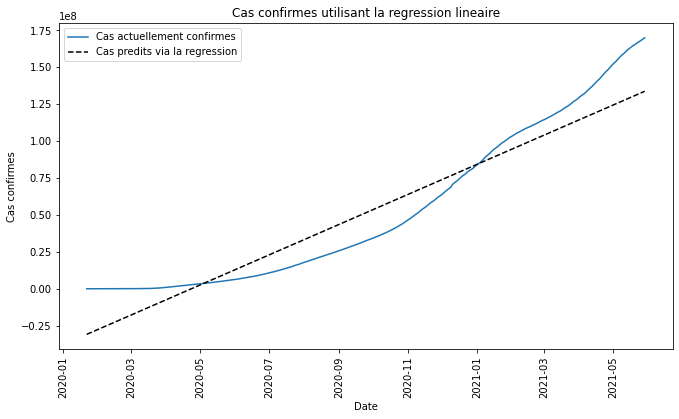

In [134]:
plt.figure(figsize=(11,6))
prediction_linreg=lin_reg.predict(np.array(datewise["Days Since"]).reshape(-1,1))
plt.plot(datewise["Confirmed"],label="Cas actuellement confirmes")
plt.plot(datewise.index,prediction_linreg, linestyle='--',label="Cas predits via la regression",color='black')
plt.xlabel('Date')
plt.ylabel('Cas confirmes')
plt.title("Cas confirmes utilisant la regression lineaire")
plt.xticks(rotation=90)
plt.legend()

In [135]:
#--------------------------- SVM -------------------------
train_ml = datewise.iloc[:int(datewise.shape[0]*0.95)]
valid_ml = datewise.iloc[int(datewise.shape[0]*0.95):]

In [137]:
from sklearn.svm import SVR
svm = SVR(C = 1, degree = 5, kernel = 'poly', epsilon = 0.01) # initialisation du modele

In [138]:
svm.fit(np.array(train_ml["Days Since"]).reshape(-1,1), np.array(train_ml["Confirmed"]).reshape(-1,1))

c:\python39\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().



SVR(C=1, degree=5, epsilon=0.01, kernel='poly')

In [139]:
prediction_valid_svm = svm.predict(np.array(valid_ml["Days Since"]).reshape(-1,1))

In [140]:
model_scores.append(np.sqrt(mean_squared_error(valid_ml["Confirmed"], prediction_valid_svm)))

print("Root Mean Square Error for Support Vectore Machine: ", np.sqrt(mean_squared_error(valid_ml["Confirmed"], prediction_valid_svm)))

Root Mean Square Error for Support Vectore Machine:  113734880.92125781


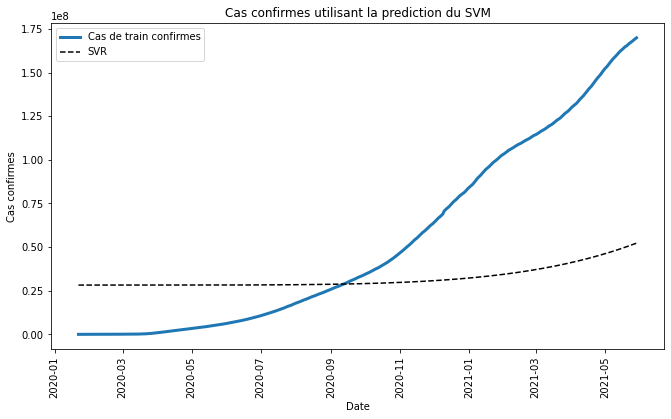

In [143]:
plt.figure(figsize = (11,6))
prediction_svm = svm.predict(np.array(datewise["Days Since"]).reshape(-1,1))
plt.plot(datewise["Confirmed"],label = "Cas de train confirmes",linewidth = 3)
plt.plot(datewise.index,prediction_svm, linestyle = '--',label = "SVR",color = 'black')
plt.xlabel('Date')
plt.ylabel('Cas confirmes')
plt.title("Cas confirmes utilisant la prediction du SVM")
plt.xticks(rotation = 90)
plt.legend()